In [176]:
import os
import cv2
import glob
import pathlib
import PIL, PIL.Image
import numpy as np
import tensorflow as tf
from tensorflow import keras
from keras import layers
import logging

In [177]:
base_dir = '/content/drive/MyDrive'
data_dir = os.path.join(base_dir, 'BSc_Project', 'out')
dataset_path = os.path.join(data_dir, 'A')

In [178]:
height = 224
width = 224

image_list = []
for cat in os.listdir(dataset_path):
  images_path = os.path.join(dataset_path, cat)
  images_names = [os.path.join(images_path, name) for name in os.listdir(images_path)]
  for image_dir in images_names:
    src = cv2.imread(image_dir)
    src_rgb = cv2.cvtColor(src, cv2.COLOR_BGR2RGB)
    image = cv2.resize(src_rgb, (width, height))
    image = image.astype('float32') / 255.
    image_list.append(image)


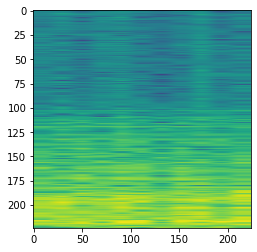

In [179]:
import matplotlib.pyplot as plt

i = 2
plt.imshow(image_list[i])
plt.show()

In [180]:
print("size of image_dataset:", len(image_list))
print(image_list[0].shape)

size of image_dataset: 948
(224, 224, 3)


In [181]:
def train_validation_split(data, ratio=0.9):
  length = int(len(data) * 0.9)
  return np.array(data[:length]), np.array(data[length:])


X_train, X_val = train_validation_split(image_list) 

In [182]:
X_train.shape, X_val.shape

((853, 224, 224, 3), (95, 224, 224, 3))

In [183]:
def plot_multiple_images(images, n_cols=None):
    n_cols = n_cols or len(images)
    n_rows = (len(images) - 1) // n_cols + 1
    if images.shape[-1] == 1:
        images = np.squeeze(images, axis=-1)
    plt.figure(figsize=(n_cols, n_rows))
    for index, image in enumerate(images):
        plt.subplot(n_rows, n_cols, index + 1)
        plt.imshow((image+1)/2)
        plt.axis("off")

In [184]:
def train_gan(gan, dataset, batch_size, codings_size, n_epochs=50):
    generator, discriminator = gan.layers
    for epoch in range(n_epochs):
        print("Epoch {}/{}".format(epoch + 1, n_epochs))             
        for X_batch in dataset:

            # phase 1 - training the discriminator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            generated_images = generator(noise)
            X_fake_and_real = tf.concat([generated_images, X_batch], axis=0)
            y1 = tf.constant([[0.]] * batch_size + [[1.]] * batch_size)
            discriminator.trainable = True
            discriminator.train_on_batch(X_fake_and_real, y1)

            # phase 2 - training the generator
            noise = tf.random.normal(shape=[batch_size, codings_size])
            y2 = tf.constant([[1.]] * batch_size)
            discriminator.trainable = False
            gan.train_on_batch(noise, y2)
        plot_multiple_images(generated_images, 8)              
        plt.show()    

In [185]:
tf.random.set_seed(42)
np.random.seed(42)


latent_size = 128

generator = keras.models.Sequential([
    keras.layers.Dense(56 * 56 * 128, input_shape=[latent_size]),
    keras.layers.Reshape([56, 56, 128]),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2DTranspose(64, kernel_size=5, strides=2, padding="same", activation="relu"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv2DTranspose(3, kernel_size=5, strides=2, padding="same", activation="tanh")
])

discriminator = keras.models.Sequential([
    keras.layers.Conv2D(64, kernel_size=5, strides=2, padding="same", activation=keras.layers.LeakyReLU(0.2), input_shape=[224, 224,  3]),
    keras.layers.Dropout(0.4),
    keras.layers.Conv2D(128, kernel_size=5, strides=2, padding="same", activation=keras.layers.LeakyReLU(0.2)),
    keras.layers.Dropout(0.4),
    keras.layers.Flatten(),
    keras.layers.Dense(1, activation="sigmoid") 
])

gan = keras.models.Sequential([
   generator,
   discriminator 
])


discriminator.compile(loss='binary_crossentropy', optimizer='rmsprop')
discriminator.trainable = False
gan.compile(loss='binary_crossentropy', optimizer='rmsprop')

In [186]:
batch_size = 32
### rescale for tanh (0:1 -> -1:1)
X_train_dc = X_train.reshape(-1, 224, 224, 3) * 2 - 1

dataset = tf.data.Dataset.from_tensor_slices(X_train_dc).shuffle(1000)
dataset = dataset.batch(batch_size, drop_remainder=True).prefetch(1)

Epoch 1/120


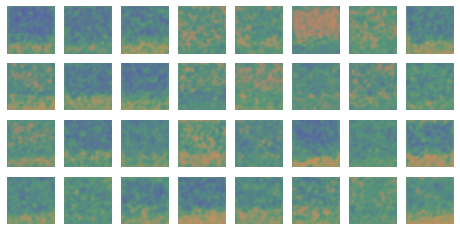

Epoch 2/120


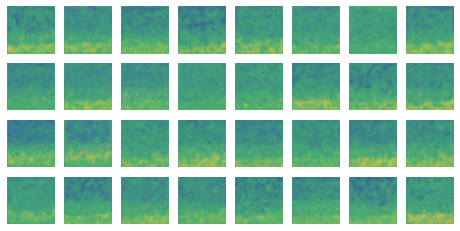

Epoch 3/120


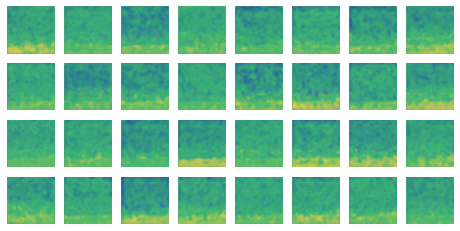

Epoch 4/120


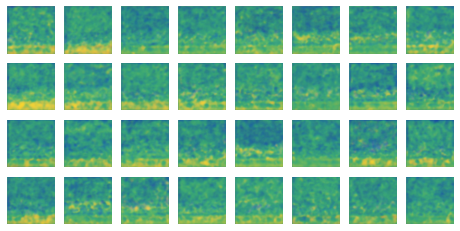

Epoch 5/120


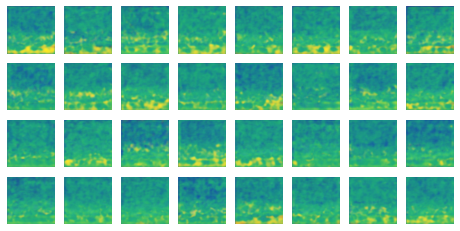

Epoch 6/120


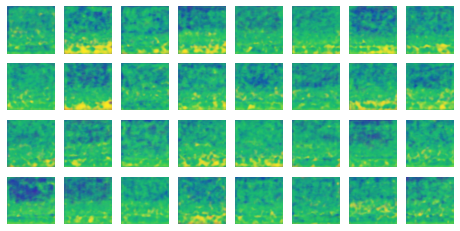

Epoch 7/120


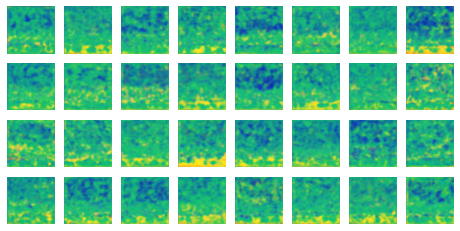

Epoch 8/120


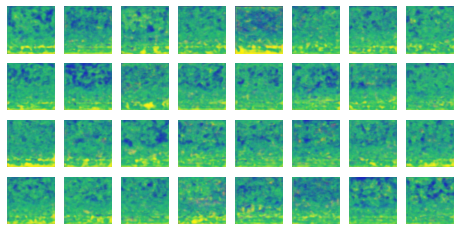

Epoch 9/120


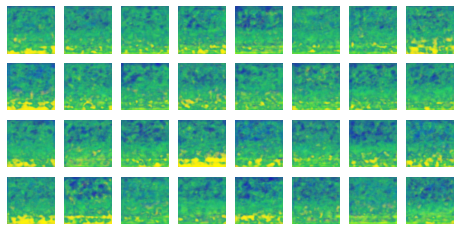

Epoch 10/120


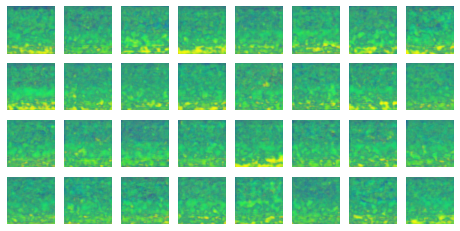

Epoch 11/120


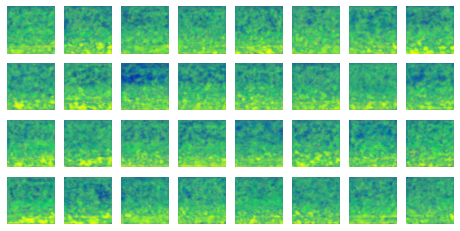

Epoch 12/120


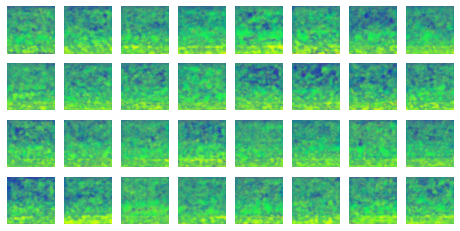

Epoch 13/120


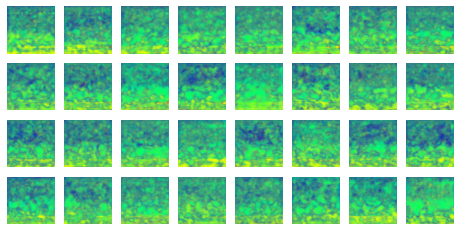

Epoch 14/120


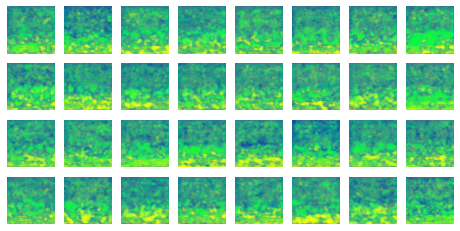

Epoch 15/120


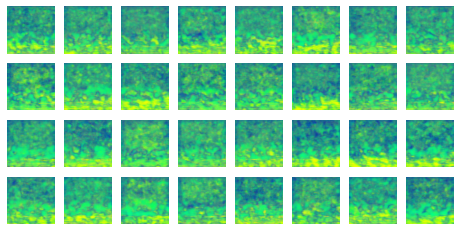

Epoch 16/120


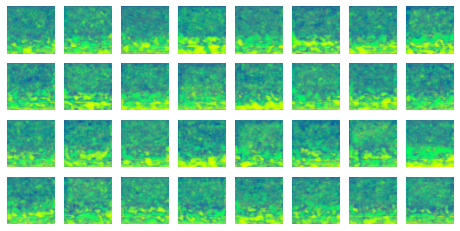

Epoch 17/120


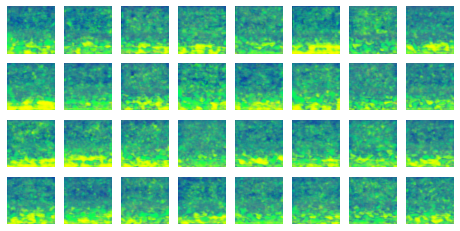

Epoch 18/120


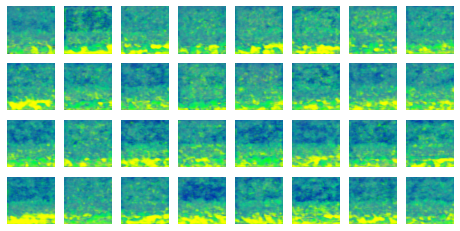

Epoch 19/120


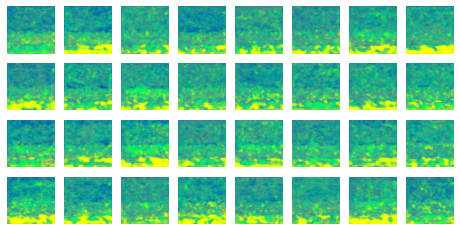

Epoch 20/120


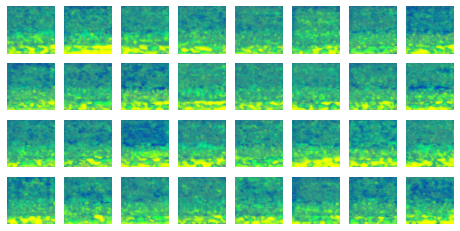

Epoch 21/120


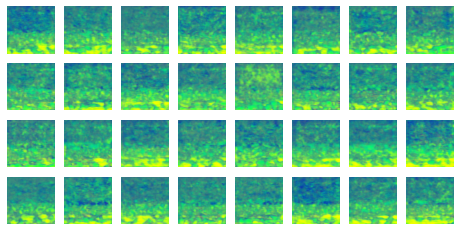

Epoch 22/120


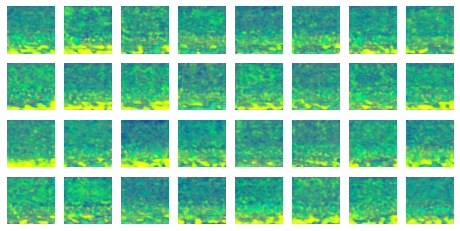

Epoch 23/120


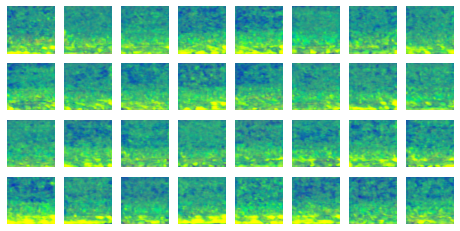

Epoch 24/120


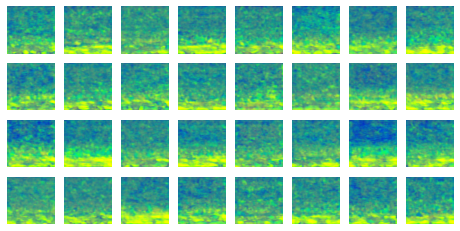

Epoch 25/120


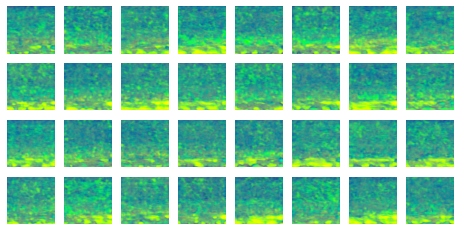

Epoch 26/120


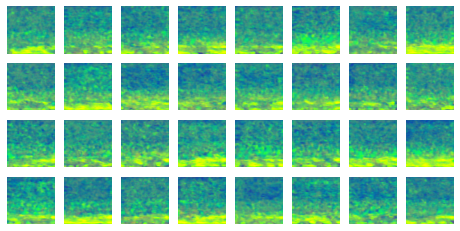

Epoch 27/120


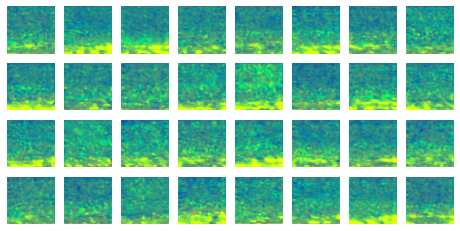

Epoch 28/120


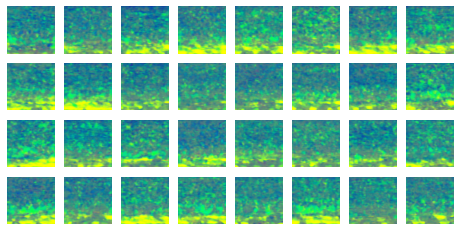

Epoch 29/120


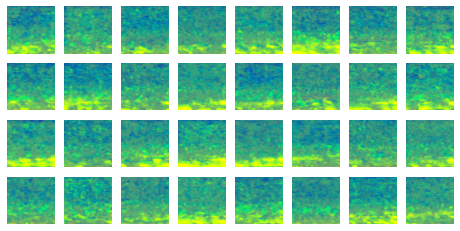

Epoch 30/120


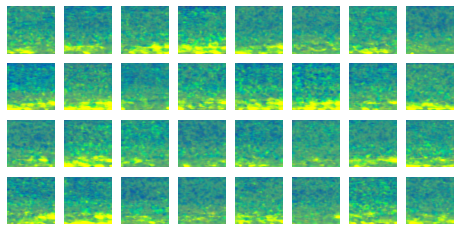

Epoch 31/120


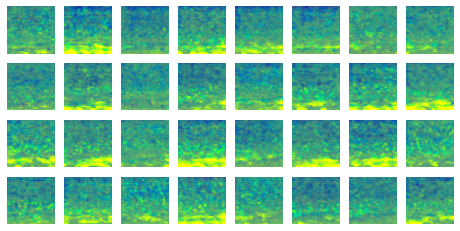

Epoch 32/120


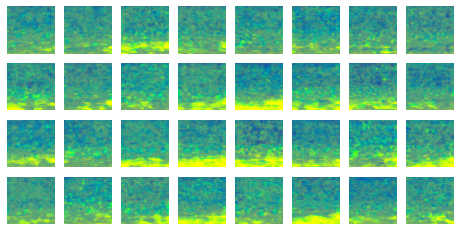

Epoch 33/120


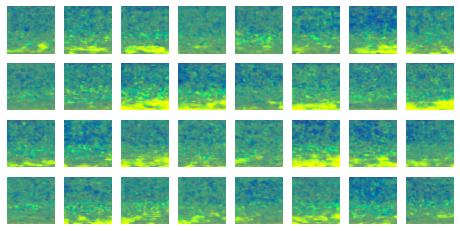

Epoch 34/120


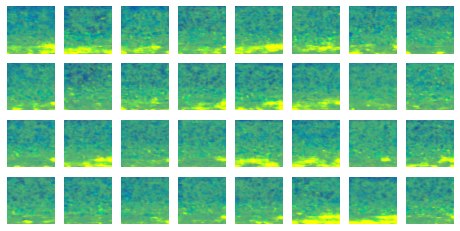

Epoch 35/120


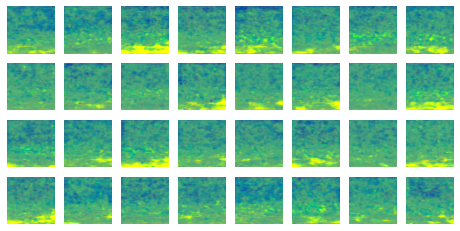

Epoch 36/120


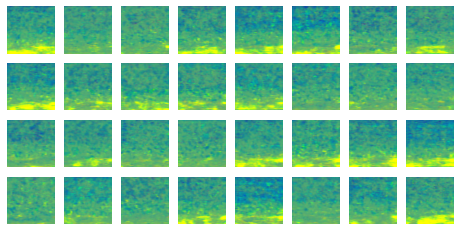

Epoch 37/120


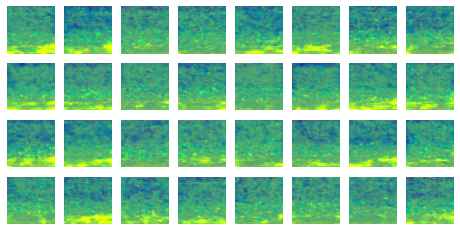

Epoch 38/120


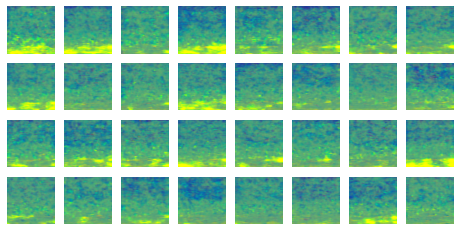

Epoch 39/120


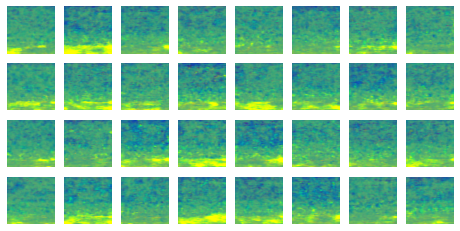

Epoch 40/120


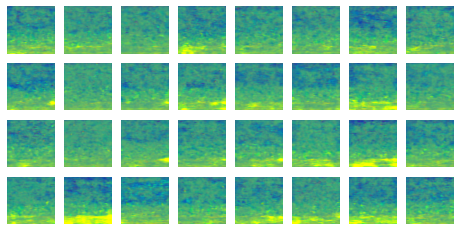

Epoch 41/120


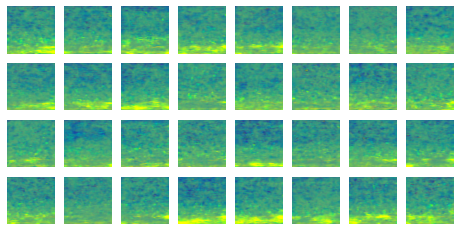

Epoch 42/120


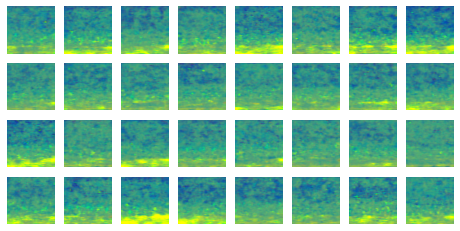

Epoch 43/120


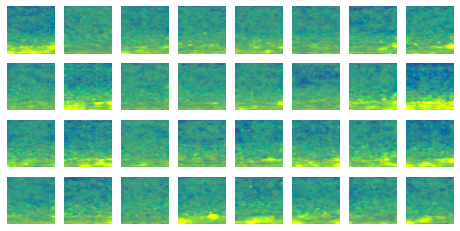

Epoch 44/120


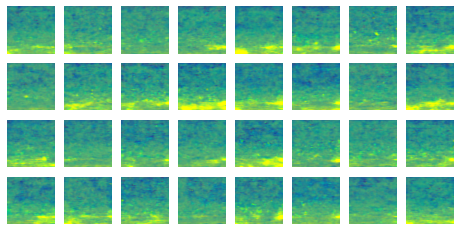

Epoch 45/120


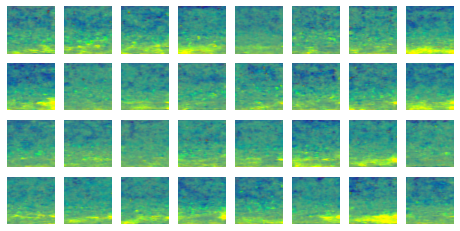

Epoch 46/120


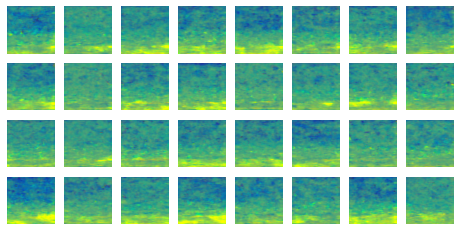

Epoch 47/120


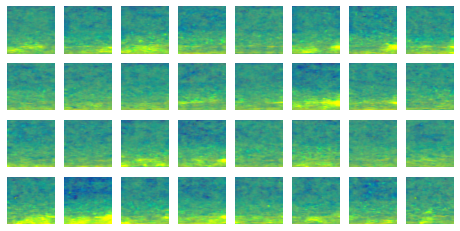

Epoch 48/120


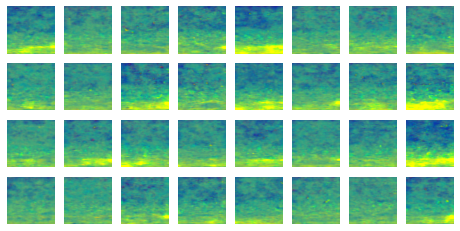

Epoch 49/120


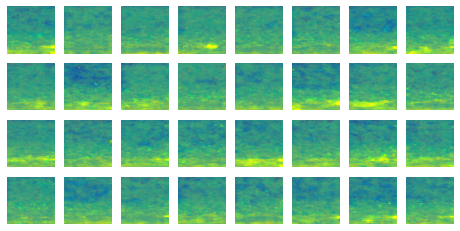

Epoch 50/120


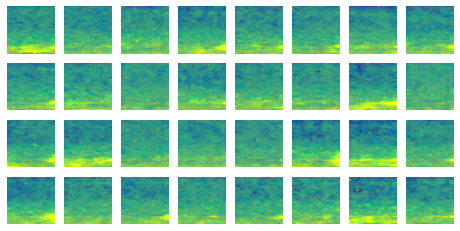

Epoch 51/120


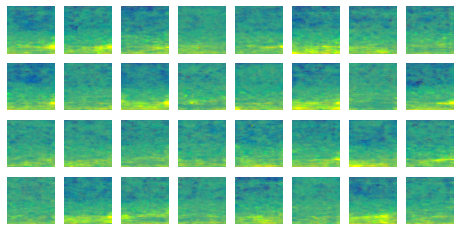

Epoch 52/120


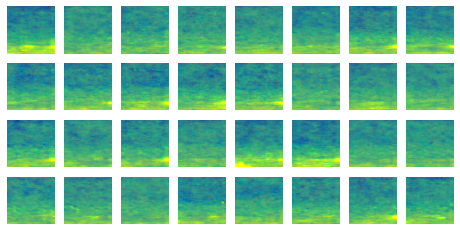

Epoch 53/120


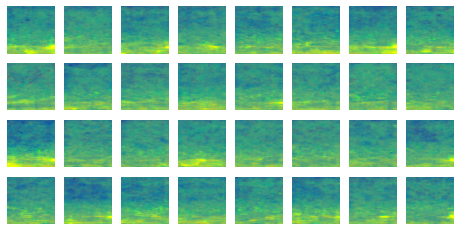

Epoch 54/120


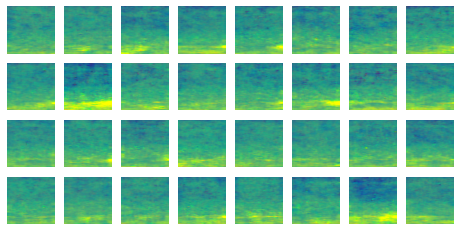

Epoch 55/120


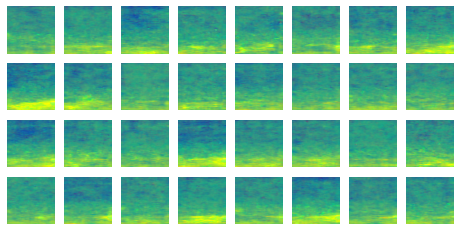

Epoch 56/120


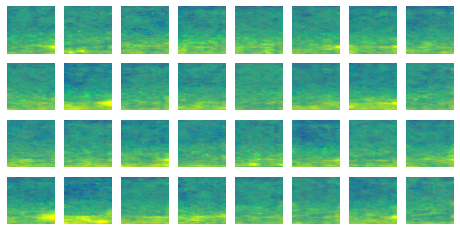

Epoch 57/120


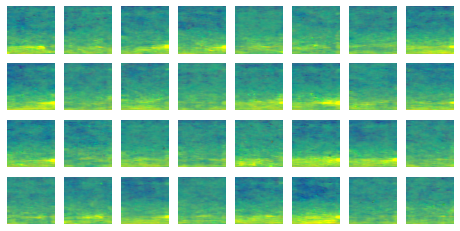

Epoch 58/120


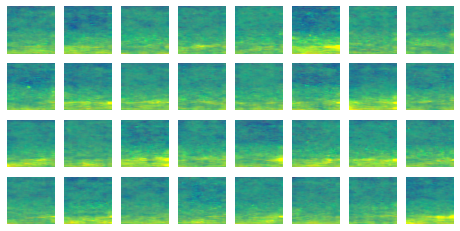

Epoch 59/120


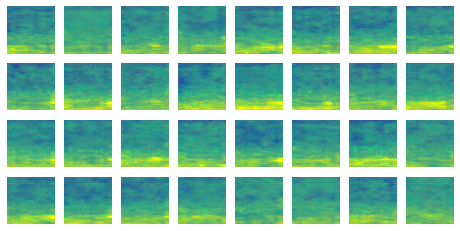

Epoch 60/120


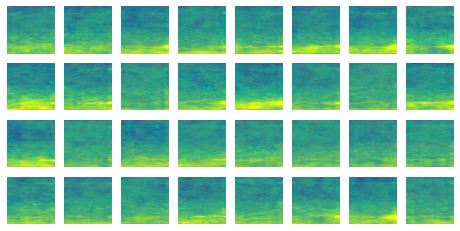

Epoch 61/120


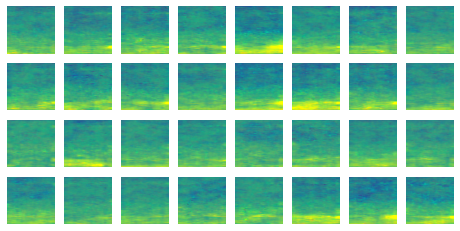

Epoch 62/120


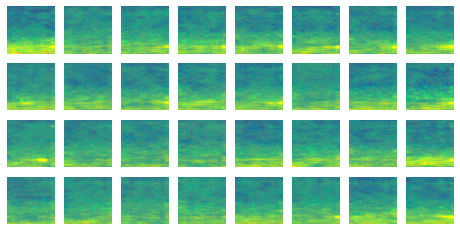

Epoch 63/120


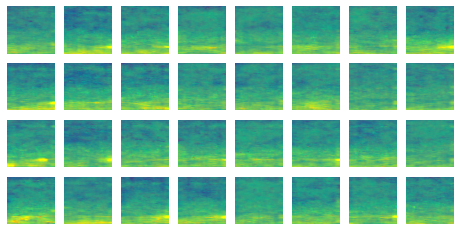

Epoch 64/120


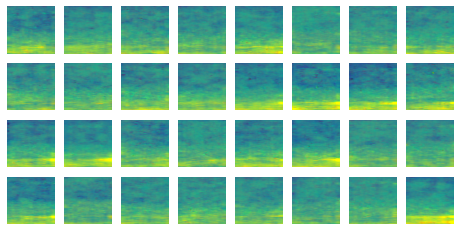

Epoch 65/120


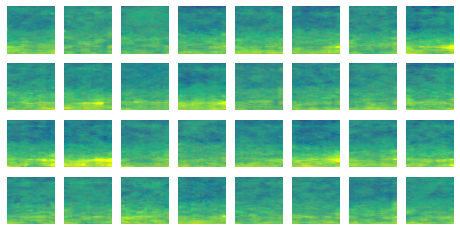

Epoch 66/120


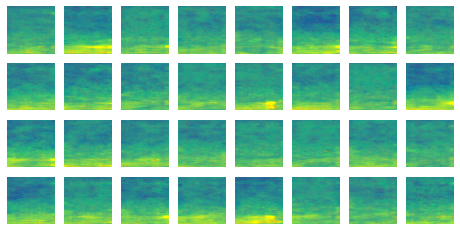

Epoch 67/120


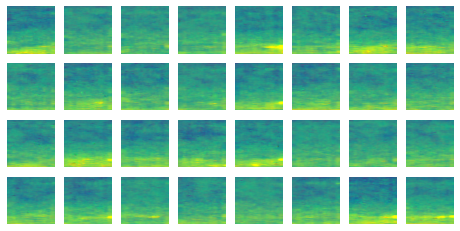

Epoch 68/120


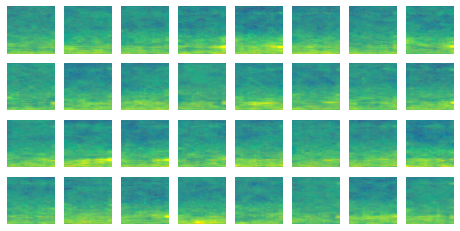

Epoch 69/120


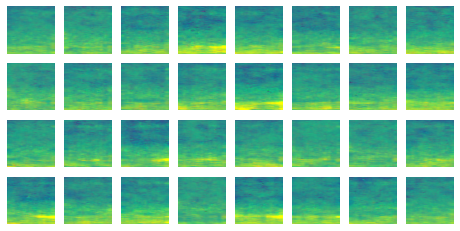

Epoch 70/120


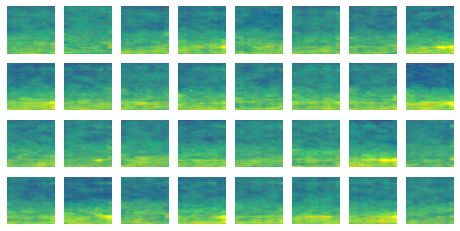

Epoch 71/120


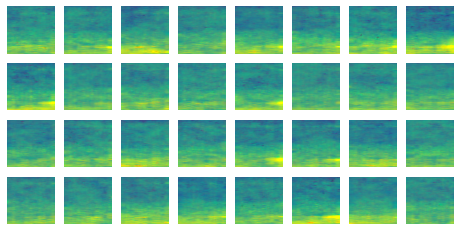

Epoch 72/120


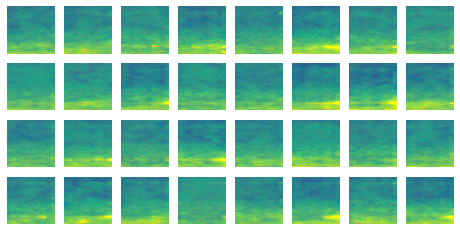

Epoch 73/120


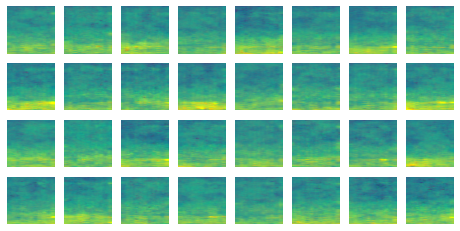

Epoch 74/120


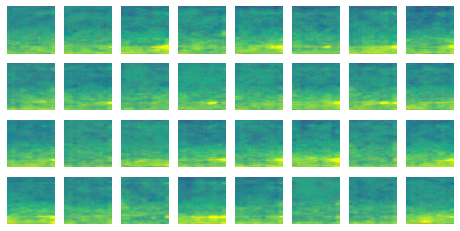

Epoch 75/120


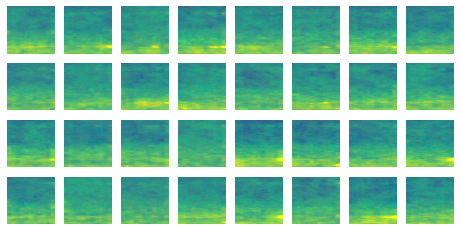

Epoch 76/120


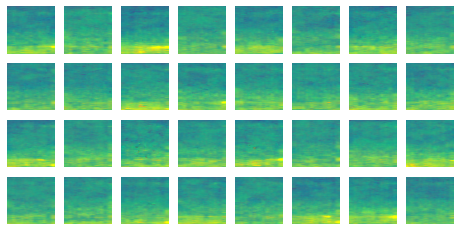

Epoch 77/120


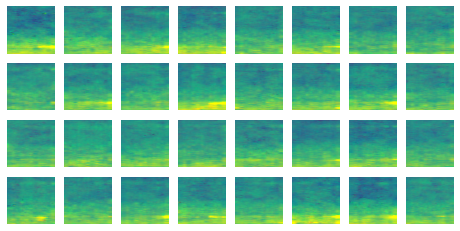

Epoch 78/120


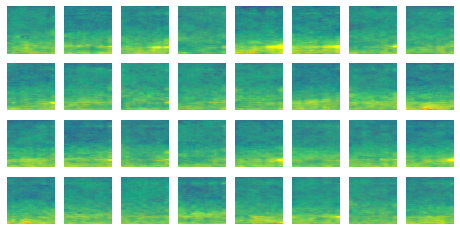

Epoch 79/120


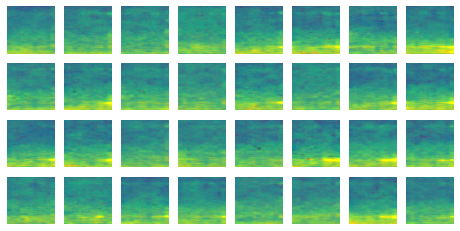

Epoch 80/120


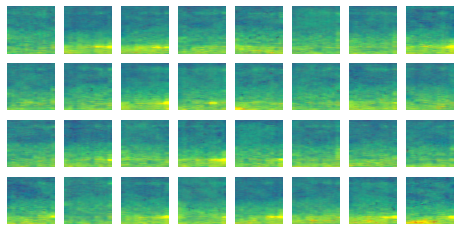

Epoch 81/120


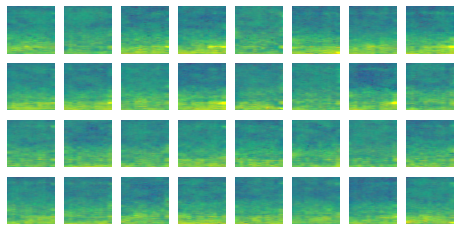

Epoch 82/120


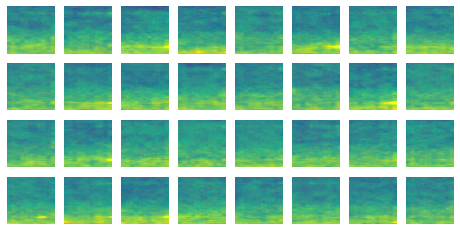

Epoch 83/120


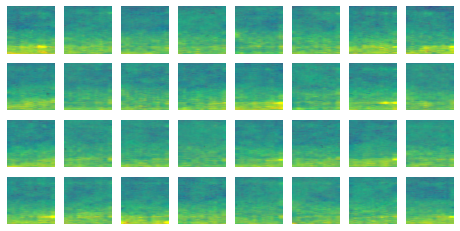

Epoch 84/120


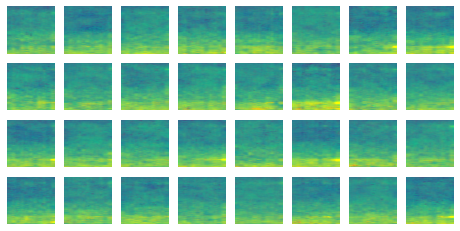

Epoch 85/120


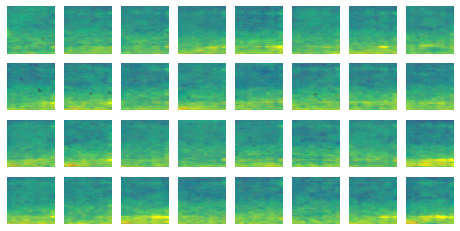

Epoch 86/120


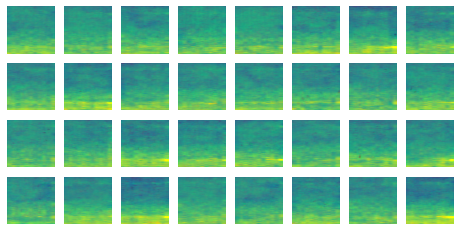

Epoch 87/120


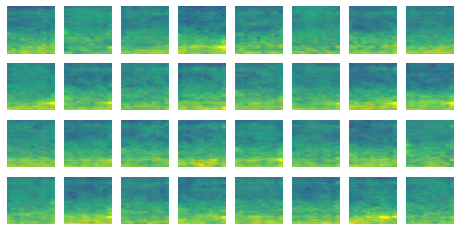

Epoch 88/120


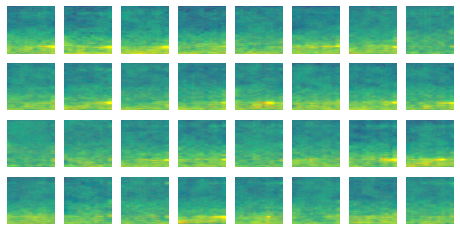

Epoch 89/120


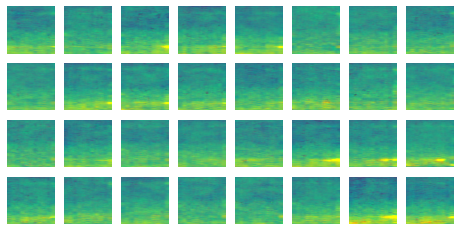

Epoch 90/120


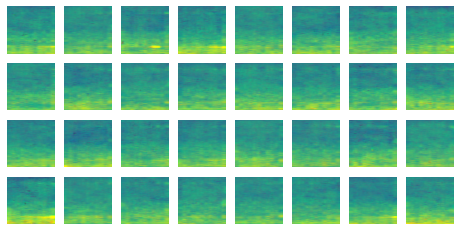

Epoch 91/120


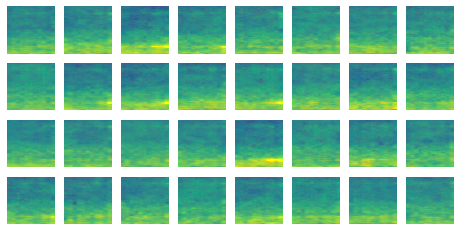

Epoch 92/120


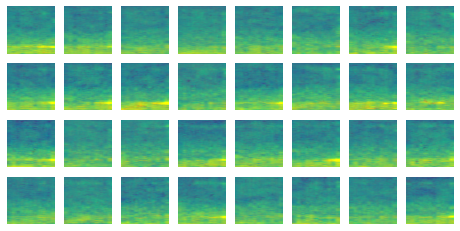

Epoch 93/120


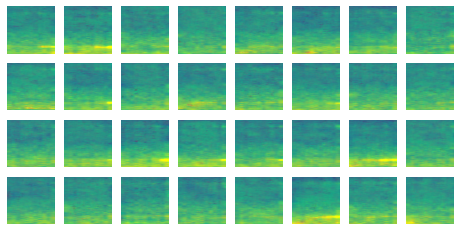

Epoch 94/120


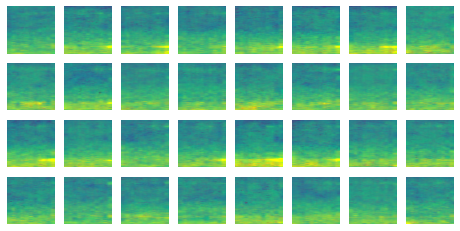

Epoch 95/120


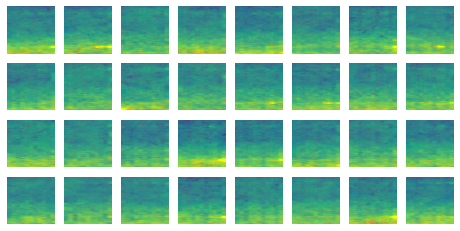

Epoch 96/120


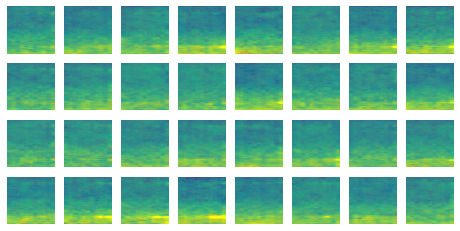

Epoch 97/120


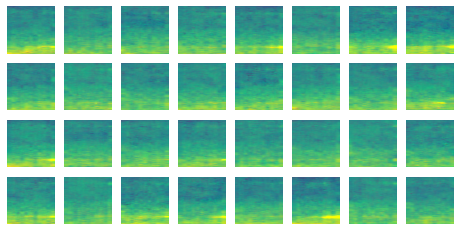

Epoch 98/120


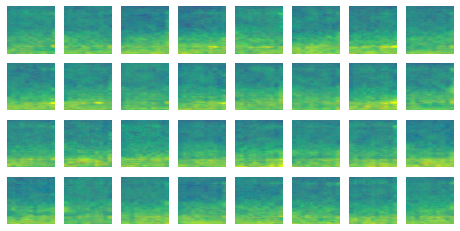

Epoch 99/120


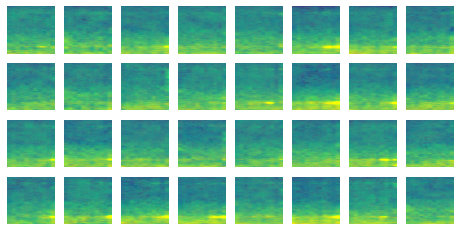

Epoch 100/120


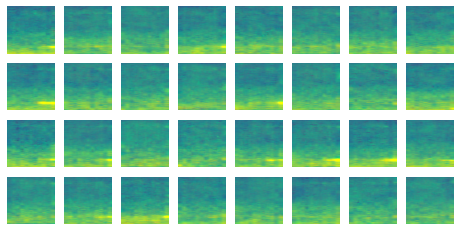

Epoch 101/120


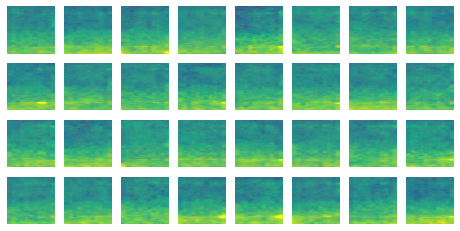

Epoch 102/120


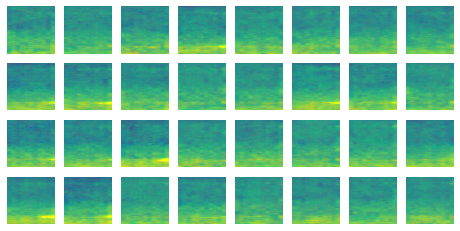

Epoch 103/120


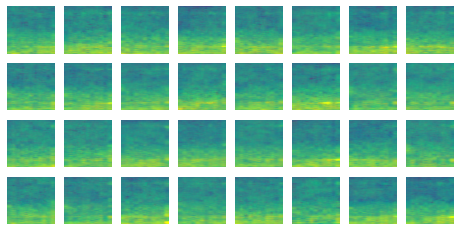

Epoch 104/120


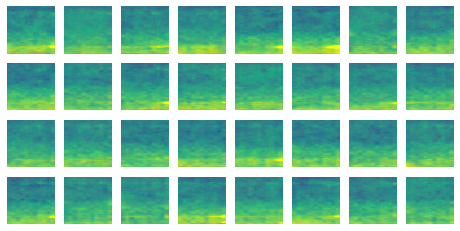

Epoch 105/120


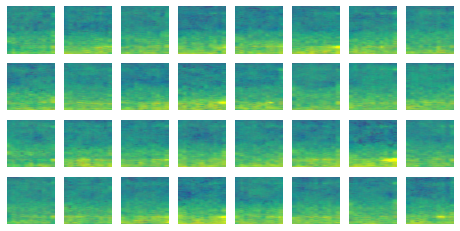

Epoch 106/120


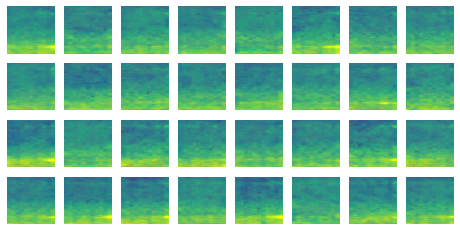

Epoch 107/120


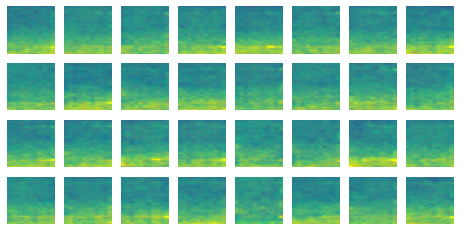

Epoch 108/120


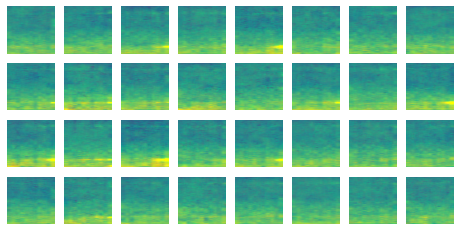

Epoch 109/120


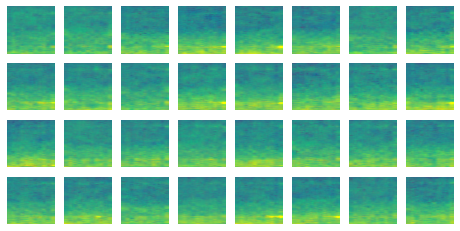

Epoch 110/120


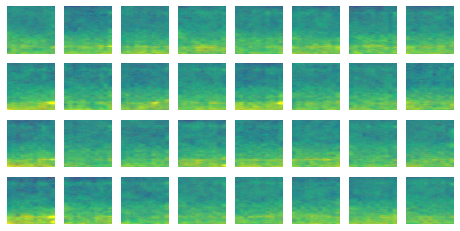

Epoch 111/120


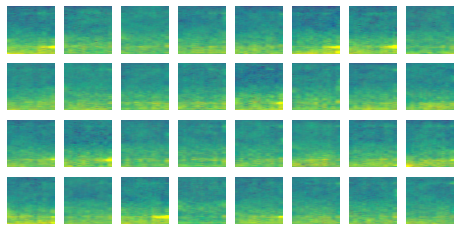

Epoch 112/120


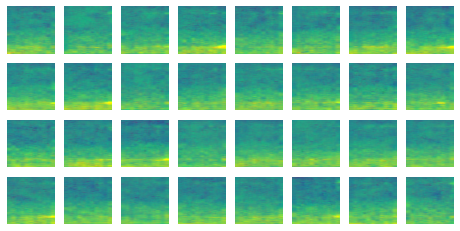

Epoch 113/120


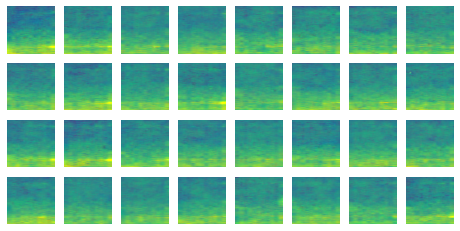

Epoch 114/120


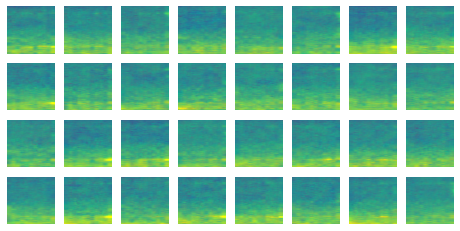

Epoch 115/120


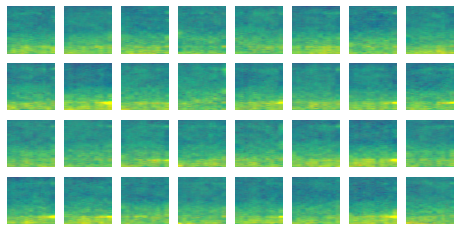

Epoch 116/120


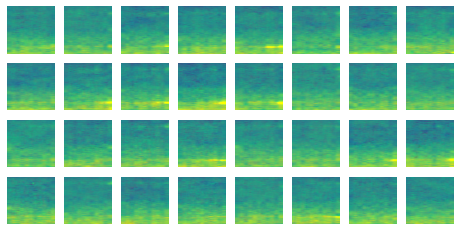

Epoch 117/120


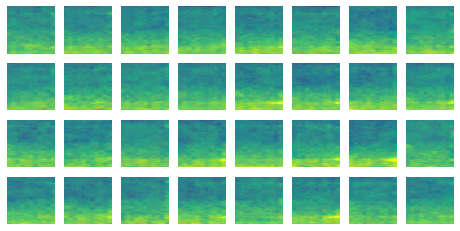

Epoch 118/120


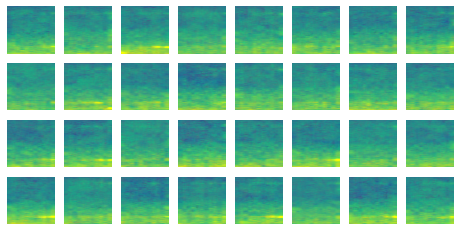

Epoch 119/120


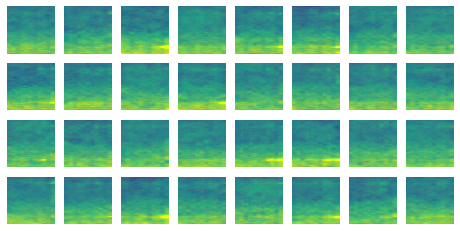

Epoch 120/120


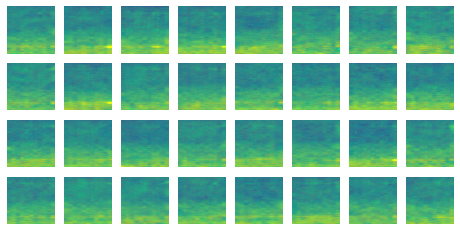

In [187]:
logger = logging.getLogger()
old_level = logger.level
logger.setLevel(100)

train_gan(gan, dataset, batch_size, latent_size, n_epochs=120)

logger.setLevel(old_level)

In [201]:
models_path = os.path.join(base_dir, 'BSc_Project', 'models')
generator.save(os.path.join(models_path, 'generator.h5'))

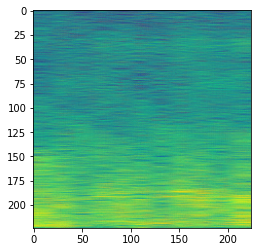

In [202]:
noise = tf.random.normal(shape=[1, latent_size])
generated_image = generator(noise)
plt.imshow((generated_image[0]+1)/2)